In [18]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from mido import MidiFile
from IPython.display import Audio, display
import random

SAMPLE_RATE = 44100
PITCH_BEND_RANGE = 2
MPE_DIR = Path('../dataset/midi_files/mpe')
MPE53_DIR = Path('../dataset/midi_files/mpe53')
PATTERNS = sorted([p.name for p in MPE53_DIR.iterdir() if p.is_dir()])
print(f'12-TET files: {len(list(MPE_DIR.glob("*.mid")))}')
print(f'Pattern folders: {PATTERNS}')

12-TET files: 48062
Pattern folders: ['8-8-5-8-8-9-7', '8-8-6-8-8-8-7', '9-7-6-9-8-8-6', '9-8-5-9-8-9-5', '9-9-4-9-9-9-4']


In [19]:
def midi_to_hz(note, bend=0):
    return 440.0 * (2 ** ((note - 69 + bend) / 12))

def extract_notes(midi_path):
    mid = MidiFile(midi_path)
    notes, active, bend, time = [], {}, [0.0] * 16, 0
    for msg in mid:
        time += msg.time
        if msg.type == 'pitchwheel':
            bend[msg.channel] = (msg.pitch / 8192) * PITCH_BEND_RANGE
        elif msg.type == 'note_on' and msg.velocity > 0:
            active[(msg.channel, msg.note)] = (time, bend[msg.channel])
        elif msg.type == 'note_off' or (msg.type == 'note_on' and msg.velocity == 0):
            key = (msg.channel, msg.note)
            if key in active:
                start, b = active.pop(key)
                notes.append((start, time, msg.note, b))
    return notes

def render_midi(midi_path, use_pitch_bend=True, max_duration=60):
    mid = MidiFile(midi_path)
    samples = int(min(mid.length, max_duration) * SAMPLE_RATE)
    audio = np.zeros(samples, dtype=np.float32)
    active, bend, pos = {}, [0.0] * 16, 0
    for msg in mid:
        pos += int(msg.time * SAMPLE_RATE)
        if pos >= samples: break
        if msg.type == 'note_on' and msg.velocity > 0:
            active[(msg.channel, msg.note)] = {'start': pos, 'vel': msg.velocity/127, 'note': msg.note, 'ch': msg.channel, 'freq': midi_to_hz(msg.note, bend[msg.channel] if use_pitch_bend else 0)}
        elif msg.type == 'note_off' or (msg.type == 'note_on' and msg.velocity == 0):
            key = (msg.channel, msg.note)
            if key in active:
                d = active.pop(key)
                length = min(pos, samples) - d['start']
                if length > 0:
                    t = np.arange(length) / SAMPLE_RATE
                    wave = np.sin(2*np.pi*d['freq']*t) + 0.3*np.sin(4*np.pi*d['freq']*t) + 0.15*np.sin(6*np.pi*d['freq']*t)
                    env = np.ones(length)
                    att, rel = min(int(0.01*SAMPLE_RATE), length), min(int(0.05*SAMPLE_RATE), length)
                    env[:att], env[-rel:] = np.linspace(0,1,att), np.linspace(1,0,rel)
                    audio[d['start']:d['start']+length] += wave * env * d['vel'] * 0.15
        elif msg.type == 'pitchwheel' and use_pitch_bend:
            bend[msg.channel] = (msg.pitch / 8192) * PITCH_BEND_RANGE
            for d in active.values():
                if d['ch'] == msg.channel: d['freq'] = midi_to_hz(d['note'], bend[msg.channel])
    return audio / max(np.max(np.abs(audio)), 1e-6) * 0.8

def get_file_id(path):
    return path.stem.replace('53TET_', '').split('_', 1)[0]

def find_53tet_files(file_12):
    rest = file_12.stem.split('_', 1)[1] if '_' in file_12.stem else ''
    fid = get_file_id(file_12)
    expected = f'53TET_{fid}_{rest}.mid' if rest else f'53TET_{fid}.mid'
    return {p: MPE53_DIR / p / expected for p in PATTERNS if (MPE53_DIR / p / expected).exists()}

def plot_comparison(file_12, files_53, max_duration=60):
    n = len(files_53)
    colors = plt.cm.tab10(np.linspace(0, 1, n + 1))
    pattern_data = {p: extract_notes(str(path)) for p, path in files_53.items()}
    
    # Fig 1: Pitch bend timeline + per-note comparison
    fig, axes = plt.subplots(2, 1, figsize=(14, 8))
    ax = axes[0]
    for i, (pattern, notes) in enumerate(pattern_data.items()):
        times = [n[0] for n in notes if n[0] < max_duration and abs(n[3]) > 0.001]
        bends = [n[3] for n in notes if n[0] < max_duration and abs(n[3]) > 0.001]
        ax.scatter(times, bends, alpha=0.6, s=20, label=pattern, color=colors[i+1])
    ax.axhline(0, color='black', linestyle='-', linewidth=1, alpha=0.5)
    ax.set_xlabel('Time (seconds)')
    ax.set_ylabel('Pitch Bend (semitones)')
    ax.set_title('Microtonal Deviations Over Time - Pattern Comparison', fontweight='bold')
    ax.legend(loc='upper right')
    ax.grid(True, alpha=0.3)
    
    ax = axes[1]
    note_bends = {}
    for pattern, notes in pattern_data.items():
        for _, _, midi_note, bend in notes:
            if abs(bend) > 0.001:
                if midi_note not in note_bends: note_bends[midi_note] = {}
                if pattern not in note_bends[midi_note]: note_bends[midi_note][pattern] = []
                note_bends[midi_note][pattern].append(bend)
    sorted_notes = sorted(note_bends.keys())
    x = np.arange(len(sorted_notes))
    width = 0.8 / n
    for i, pattern in enumerate(files_53.keys()):
        avg_bends = [np.mean(note_bends[note].get(pattern, [0])) if note in note_bends else 0 for note in sorted_notes]
        ax.bar(x + i * width - 0.4 + width/2, avg_bends, width, label=pattern, color=colors[i+1], alpha=0.8)
    ax.set_xlabel('MIDI Note')
    ax.set_ylabel('Avg Pitch Bend (semitones)')
    ax.set_title('Average Microtonal Adjustment per Note - Pattern Comparison', fontweight='bold')
    ax.set_xticks(x)
    ax.set_xticklabels([str(n) for n in sorted_notes], rotation=45, ha='right', fontsize=8)
    ax.axhline(0, color='black', linestyle='-', linewidth=1)
    ax.legend(loc='upper right')
    ax.grid(True, alpha=0.3, axis='y')
    plt.tight_layout()
    plt.show()
    
    # Fig 2: Heatmap
    if n > 1:
        fig, ax = plt.subplots(figsize=(10, 6))
        patterns = list(files_53.keys())
        stats = []
        for p in patterns:
            bends = [note[3] for note in pattern_data[p] if abs(note[3]) > 0.001]
            stats.append([np.mean(bends), np.std(bends), np.min(bends), np.max(bends), len(bends)] if bends else [0,0,0,0,0])
        stats = np.array(stats)
        im = ax.imshow(stats, aspect='auto', cmap='RdYlBu_r')
        ax.set_yticks(range(len(patterns)))
        ax.set_yticklabels(patterns)
        ax.set_xticks(range(5))
        ax.set_xticklabels(['Mean', 'Std Dev', 'Min', 'Max', 'Count'])
        ax.set_title('Microtonal Statistics by Pattern', fontweight='bold')
        for i in range(len(patterns)):
            for j in range(5):
                val = stats[i, j]
                text = f'{val:.3f}' if j < 4 else f'{int(val)}'
                ax.text(j, i, text, ha='center', va='center', fontsize=9, color='white' if abs(val) > np.max(np.abs(stats))/2 else 'black')
        plt.colorbar(im, ax=ax, label='Value')
        plt.tight_layout()
        plt.show()
    
    # Fig 3: Histogram
    fig, ax = plt.subplots(figsize=(12, 5))
    for i, (pattern, notes) in enumerate(pattern_data.items()):
        bends = [n[3] for n in notes if abs(n[3]) > 0.001]
        if bends: ax.hist(bends, bins=40, alpha=0.5, label=f'{pattern} (n={len(bends)})', color=colors[i+1], edgecolor='black', linewidth=0.5)
    ax.axvline(0, color='red', linestyle='--', linewidth=2, label='12-TET reference')
    ax.set_xlabel('Pitch Bend (semitones)')
    ax.set_ylabel('Frequency')
    ax.set_title('Distribution of Microtonal Deviations - How Patterns Differ', fontweight='bold')
    ax.legend()
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    print('\n' + '=' * 70)
    print('PATTERN COMPARISON SUMMARY')
    print('=' * 70)
    print(f'{"Pattern":<20} {"Mean Bend":>12} {"Std Dev":>12} {"Range":>20}')
    print('-' * 70)
    for pattern, notes in pattern_data.items():
        bends = [n[3] for n in notes if abs(n[3]) > 0.001]
        if bends: print(f'{pattern:<20} {np.mean(bends):>+12.4f} {np.std(bends):>12.4f} [{min(bends):+.3f}, {max(bends):+.3f}]')
    print('-' * 70)

def compare_song(file_id, max_duration=60, show_visual=True):
    files_12 = list(MPE_DIR.glob('*.mid'))
    file_12 = next((f for f in files_12 if get_file_id(f) == file_id), None)
    if not file_12: print(f'No 12-TET file with ID: {file_id}'); return
    files_53 = find_53tet_files(file_12)
    song_name = file_12.stem.split('_', 1)[1] if '_' in file_12.stem else file_12.stem
    print(f'{song_name}')
    print('=' * 60)
    if show_visual and files_53: plot_comparison(file_12, files_53, max_duration)
    print('\n12-TET (Original):')
    display(Audio(render_midi(str(file_12), use_pitch_bend=False, max_duration=max_duration), rate=SAMPLE_RATE))
    if not files_53: print('No 53-TET augmentations found'); return
    for pattern, path in files_53.items():
        print(f'\n53-TET [{pattern}]:')
        display(Audio(render_midi(str(path), use_pitch_bend=True, max_duration=max_duration), rate=SAMPLE_RATE))
    print(f'\nFound {len(files_53)} augmentations: {list(files_53.keys())}')

## Compare Random Song

In [ ]:
files = list(MPE_DIR.glob('*.mid'))
if files:
    compare_song(get_file_id(random.choice(files)))
else:
    print('No files found')

## Compare Specific Song

In [ ]:
files = sorted(MPE_DIR.glob('*.mid'))
print(f"{'ID':<8} {'Song Name'}")
print('-' * 70)
for f in files[:20]:
    parts = f.stem.split('_', 1)
    print(f"{parts[0]:<8} {parts[1] if len(parts) > 1 else '(no name)'}")

A Felicidade 1_G_minor


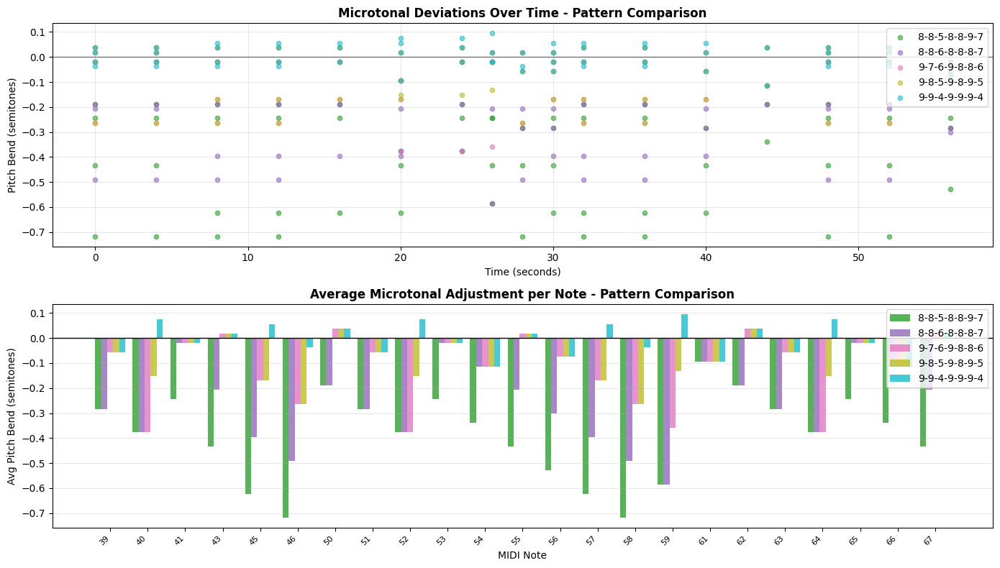

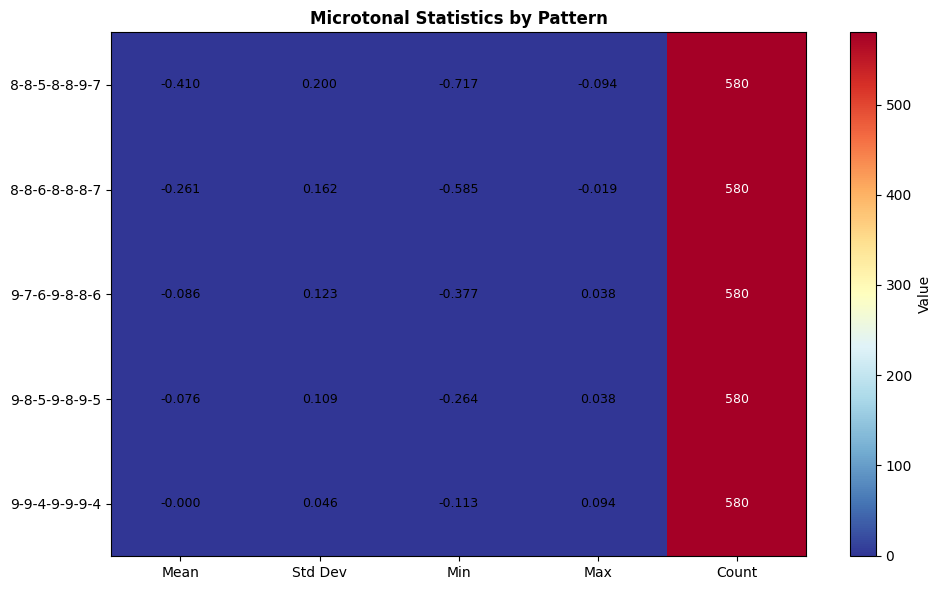

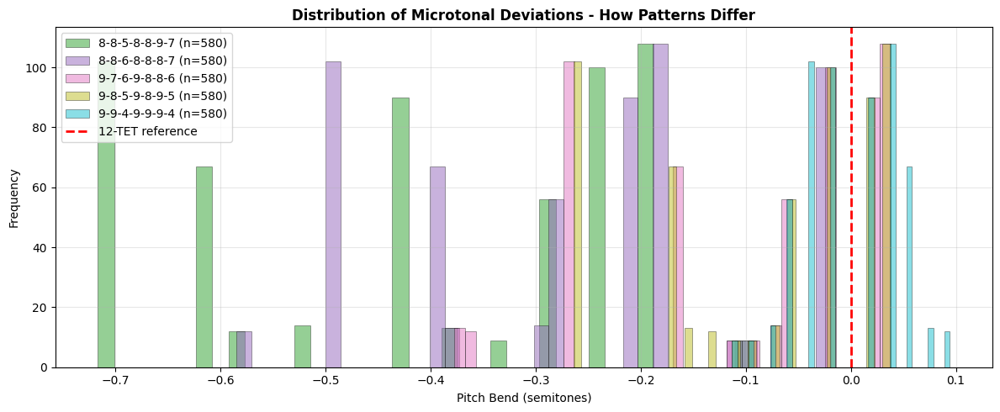


PATTERN COMPARISON SUMMARY
Pattern                 Mean Bend      Std Dev                Range
----------------------------------------------------------------------
8-8-5-8-8-9-7             -0.4100       0.1996 [-0.717, -0.094]
8-8-6-8-8-8-7             -0.2609       0.1620 [-0.585, -0.019]
9-7-6-9-8-8-6             -0.0857       0.1234 [-0.377, +0.038]
9-8-5-9-8-9-5             -0.0759       0.1088 [-0.264, +0.038]
9-9-4-9-9-9-4             -0.0003       0.0457 [-0.113, +0.094]
----------------------------------------------------------------------

12-TET (Original):



53-TET [8-8-5-8-8-9-7]:



53-TET [8-8-6-8-8-8-7]:



53-TET [9-7-6-9-8-8-6]:



53-TET [9-8-5-9-8-9-5]:



53-TET [9-9-4-9-9-9-4]:



Found 5 augmentations: ['8-8-5-8-8-9-7', '8-8-6-8-8-8-7', '9-7-6-9-8-8-6', '9-8-5-9-8-9-5', '9-9-4-9-9-9-4']


In [20]:
compare_song('13651')